In [6]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!pip install mljar-supervised
!pip install joblib==1.2.0

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 112.7/112.7 kB 7.4 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 76.6/76.6 MB 13.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 90.5/90.5 kB 13.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 572.4/572.4 kB 37.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 81.2/81.2 kB 11.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 365.7/365.7 kB 41.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 212.3/212.3 kB 29.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.7/78.7 kB 11.9 MB/s eta 0:00:00
  Created wheel for mljar-supervised: filename=mljar_supervised-0.11.5-py3-none-any.whl size=147060 sha256=75d8929dda61720c3189206eef7df9b7321980cb07acd3f318f1527d57a4f948
  Stored in directory: /root/.cache/pip/

In [4]:
# set project folder directory
DATA_DIR = '/content/drive/MyDrive/W281 Project/data'

In [7]:
# load some lib
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
from tqdm.notebook import tqdm
import joblib
import pickle
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import classification_report,roc_curve
import tensorflow as tf
from tensorflow import keras
from keras import metrics
tf.get_logger().setLevel('INFO')

# read in metadata
df_meta = pd.read_csv(f"{DATA_DIR}/raw/Chest_xray_Corona_Metadata.csv", index_col = 0)
df_meta

,X_ray_image_name,Label,Dataset_type,Label_2_Virus_category,Label_1_Virus_category
0,IM-0128-0001.jpeg,Normal,TRAIN,NaN,NaN
1,IM-0127-0001.jpeg,Normal,TRAIN,NaN,NaN
2,IM-0125-0001.jpeg,Normal,TRAIN,NaN,NaN
3,IM-0122-0001.jpeg,Normal,TRAIN,NaN,NaN
4,IM-0119-0001.jpeg,Normal,TRAIN,NaN,NaN
...,...,...,...,...,...
5928,person1637_virus_2834.jpeg,Pnemonia,TEST,NaN,Virus
5929,person1635_virus_2831.jpeg,Pnemonia,TEST,NaN,Virus
5930,person1634_virus_2830.jpeg,Pnemonia,TEST,NaN,Virus
5931,person1633_virus_2829.jpeg,Pnemonia,TEST,NaN,Virus


# Loading Data
Begining Modeling

In [8]:
import pickle

In [17]:
# import data - This should be feature sepecfific
# NOTE: this step is feature specific
train_image_data = pickle.load(open(f"{DATA_DIR}/processed/hsv_hist_train_image_data.pkl", "rb"))
train_label = pickle.load(open(f"{DATA_DIR}/processed/hsv_hist_train_labels.pkl", "rb"))
# train_label = np.array(train_label).astype(int)

# loading test set
test_image_data =  pickle.load(open(f"{DATA_DIR}/processed/hsv_hist_test_image_data.pkl", "rb"))
test_label =  pickle.load(open(f"{DATA_DIR}/processed/hsv_hist_test_labels.pkl", "rb"))
# test_label = np.array(test_label).astype(int)

In [18]:
print(test_label)

[0 0 0 ... 1 1 1]


In [19]:
from sklearn.decomposition import PCA

# compute PCA on the SIFT features
# applying PCA components = 10 or 20 from earlier analysis
# let's do 10 to reduce the training time a little bit
pca=PCA(n_components=10) 
train_image_data_pca=pca.fit_transform(train_image_data)

# applying the same transformation on the test image data
test_image_data_pca=pca.transform(test_image_data)

# Training Simple Multiclass Logistic Regression
Utilizing SIFT features only, train a simple logistic regression

In [20]:
def build_model(n_classes,
                hidden_layer_sizes=[],
                activation='relu',
                optimizer='SGD',
                learning_rate=0.01):
  """Build a multi-class logistic regression model using Keras.

  Args:
    n_classes: Number of output classes in the dataset.
    hidden_layer_sizes: A list with the number of units in each hidden layer.
    activation: The activation function to use for the hidden layers.
    optimizer: The optimizer to use (SGD, Adam).
    learning_rate: The desired learning rate for the optimizer.

  Returns:
    model: A tf.keras model (graph).
  """
  tf.keras.backend.clear_session()
  np.random.seed(0)
  tf.random.set_seed(0)

  # 1. declare a keras sequential model that's 
  # 2. add first layer for a flatten input layer
  # 3. add dense hidden layer size based on the input list 
  # 4. add a final output layer with softmax activation for multi-class classification purposes
  model = keras.Sequential()
  model.add(keras.layers.Flatten())

  for layer_size in hidden_layer_sizes:
    model.add(keras.layers.Dense(
      units=layer_size,
      activation=activation
    ))

  model.add(keras.layers.Dense(
      units=n_classes,
      activation='softmax'
  ))


  # 5. instantiate an optimization based on input
  if optimizer == 'SGD':
    op = tf.keras.optimizers.SGD(learning_rate=learning_rate)
  elif optimizer == 'Adam':
    op = tf.keras.optimizers.Adam(learning_rate=learning_rate)

  # compile the model with an opimizer
  model.compile(loss="sparse_categorical_crossentropy", 
                optimizer=op, 
                metrics=['accuracy'])


  return model

In [21]:
# Build the model.
log_reg_model = build_model(n_classes=3, 
                    hidden_layer_sizes=[512, 256],
                    activation='relu',
                    optimizer='Adam',
                    learning_rate=0.01)


# keras.utils.plot_model(log_reg_model, show_shapes=True, dpi=90)               

In [22]:
history = log_reg_model.fit(
  x=train_image_data_pca,
  y=train_label,
  epochs=10,
  batch_size=64,
  validation_split=0.1)

Epoch 1/10
373/373 [==============================] - 4s 6ms/step - loss: 9.1933 - accuracy: 0.4772 - val_loss: 1.1117 - val_accuracy: 0.4581
Epoch 2/10
373/373 [==============================] - 2s 5ms/step - loss: 1.0503 - accuracy: 0.4818 - val_loss: 1.1384 - val_accuracy: 0.4581
Epoch 3/10
373/373 [==============================] - 2s 6ms/step - loss: 1.0509 - accuracy: 0.4811 - val_loss: 1.1160 - val_accuracy: 0.4581
Epoch 4/10
373/373 [==============================] - 3s 8ms/step - loss: 1.0507 - accuracy: 0.4811 - val_loss: 1.1013 - val_accuracy: 0.4581
Epoch 5/10
373/373 [==============================] - 2s 6ms/step - loss: 1.0508 - accuracy: 0.4811 - val_loss: 1.1041 - val_accuracy: 0.4581
Epoch 6/10
373/373 [==============================] - 2s 5ms/step - loss: 1.0509 - accuracy: 0.4811 - val_loss: 1.1195 - val_accuracy: 0.4581
Epoch 7/10
373/373 [==============================] - 2s 6ms/step - loss: 1.0510 - accuracy: 0.4811 - val_loss: 1.1065 - val_accuracy: 0.4581
Epoch 

In [23]:
joblib.dump(log_reg_model, f"{DATA_DIR}/outputs/Logistic-CLRS-HIST-.pkl")

['/content/drive/MyDrive/W281 Project/data/outputs/Logistic-CLRS-HIST-.pkl']

In [24]:
#create a code that load the model

In [25]:
y_pred = np.argmax(log_reg_model.predict(test_image_data_pca), axis=-1)
y_pred

98/98 [==============================] - 0s 2ms/step


array([2, 2, 2, ..., 2, 2, 2])

Text(220.72222222222223, 0.5, 'True')

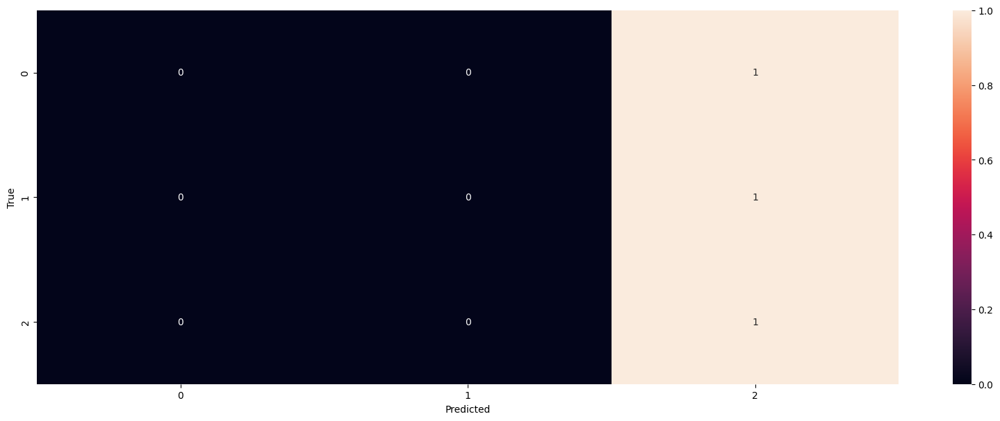

In [26]:

ccm = tf.math.confusion_matrix(test_label, y_pred)
ccm = ccm/ccm.numpy().sum(axis=1)[:, tf.newaxis]

#display that new confusion matrix
plt.figure(figsize=(20,7))
sns.heatmap(
    ccm, annot=True)
plt.xlabel("Predicted")
plt.ylabel("True")

In [27]:
print(classification_report(test_label, y_pred))

              precision    recall  f1-score   support

           0       0.00      0.00      0.00      1170
           1       0.00      0.00      0.00       740
           2       0.39      1.00      0.56      1209

    accuracy                           0.39      3119
   macro avg       0.13      0.33      0.19      3119
weighted avg       0.15      0.39      0.22      3119



/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


# Modeling USING SVM

In [28]:
# train a quick SVM
from sklearn.svm import SVC

svc_model = SVC(gamma='auto')
svc_model.fit(train_image_data_pca, train_label)

SVC(gamma='auto')

In [29]:
joblib.dump(svc_model, f"{DATA_DIR}/outputs/SVC-CLRS-HIST.pkl")

['/content/drive/MyDrive/W281 Project/data/outputs/SVC-CLRS-HIST.pkl']

In [30]:
y_pred = svc_model.predict(test_image_data_pca)
y_pred

array([2, 2, 2, ..., 2, 2, 2])

Text(220.72222222222223, 0.5, 'True')

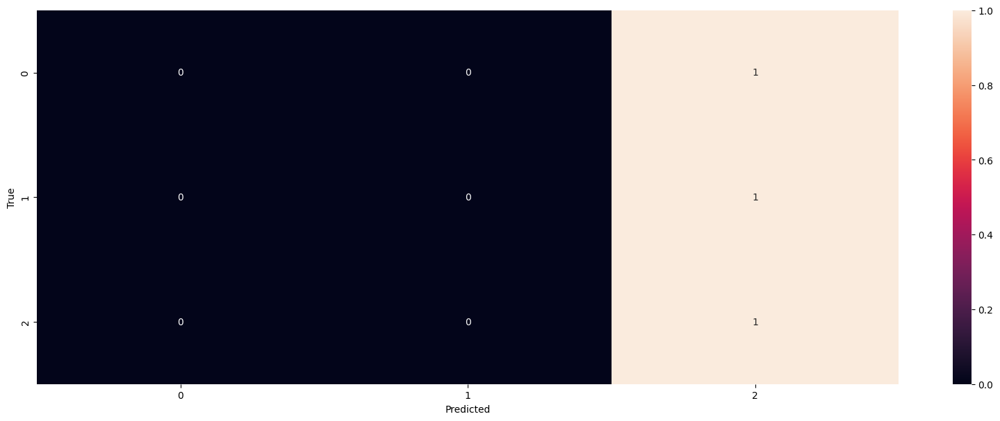

In [31]:
ccm = tf.math.confusion_matrix(test_label, y_pred)
ccm = ccm/ccm.numpy().sum(axis=1)[:, tf.newaxis]

#display that new confusion matrix
plt.figure(figsize=(20,7))
sns.heatmap(
    ccm, annot=True)
plt.xlabel("Predicted")
plt.ylabel("True")

In [32]:
print(classification_report(test_label, y_pred))

              precision    recall  f1-score   support

           0       0.00      0.00      0.00      1170
           1       0.00      0.00      0.00       740
           2       0.39      1.00      0.56      1209

    accuracy                           0.39      3119
   macro avg       0.13      0.33      0.19      3119
weighted avg       0.15      0.39      0.22      3119



/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


# Modeling Using Gradient Boosting

In [33]:
from sklearn.ensemble import GradientBoostingClassifier

gbc_model = GradientBoostingClassifier(n_estimators=300, 
                                       learning_rate=0.1,
                                      max_depth=3).fit(train_image_data_pca, 
                                                       train_label)
gbc_model.score(test_image_data_pca, test_label)

0.5421609490221225

In [34]:
joblib.dump(gbc_model, f"{DATA_DIR}/outputs/GBC-CLRS-HIST.pkl")

['/content/drive/MyDrive/W281 Project/data/outputs/GBC-CLRS-HIST.pkl']

In [35]:
y_pred = gbc_model.predict(test_image_data_pca)
y_pred

array([2, 2, 2, ..., 2, 2, 2])

Text(220.72222222222223, 0.5, 'True')

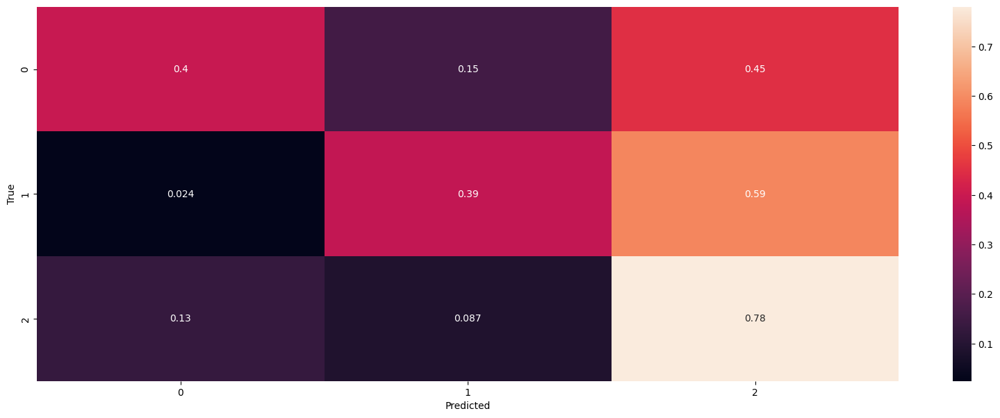

In [36]:
ccm = tf.math.confusion_matrix(test_label, y_pred)
ccm = ccm/ccm.numpy().sum(axis=1)[:, tf.newaxis]

#display that new confusion matrix
plt.figure(figsize=(20,7))
sns.heatmap(
    ccm, annot=True)
plt.xlabel("Predicted")
plt.ylabel("True")

In [37]:
print(classification_report(test_label, y_pred))

              precision    recall  f1-score   support

           0       0.72      0.40      0.51      1170
           1       0.50      0.39      0.43       740
           2       0.49      0.78      0.61      1209

    accuracy                           0.54      3119
   macro avg       0.57      0.52      0.52      3119
weighted avg       0.58      0.54      0.53      3119



In [40]:
!pip install mljar-supervised

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 112.7/112.7 kB 4.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 76.6/76.6 MB 5.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 90.5/90.5 kB 8.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 572.4/572.4 kB 38.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 81.2/81.2 kB 10.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 365.7/365.7 kB 15.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 212.3/212.3 kB 14.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.7/78.7 kB 5.6 MB/s eta 0:00:00
  Created wheel for mljar-supervised: filename=mljar_supervised-0.11.5-py3-none-any.whl size=147060 sha256=efb373320f4a9eae5e77f18af9944d4324ee78fde1e07c889228b3a3ec46575a
  Stored in directory: /root/.cache/pip/whe

In [ ]:
# performing AUTOML
# Trying AutoML to determine golden features
# also because I am lazy to try all modeling techniques...
from supervised.automl import AutoML


automl = AutoML(
    mode="Perform", 
    explain_level=1, 
    golden_features=True,
    total_time_limit=30000,
    ml_task="multiclass_classification",
    eval_metric='accuracy',
    validation_strategy={
        "validation_type": "kfold",
        "k_folds": 4,
        "shuffle": False,
        "stratify": True,
})

# upsample training 
automl.fit(train_image_data_pca, train_label)

# save the autoML for future usage
# joblib.dump(automl, f"{DATA_DIR}/outputs/CLRS-HIST-autoMLModel.pkl")

# print the nice report :)
automl.report()

Linear algorithm was disabled.
AutoML directory: AutoML_1
The task is multiclass_classification with evaluation metric accuracy
AutoML will use algorithms: ['Random Forest', 'LightGBM', 'Xgboost', 'CatBoost', 'Neural Network']
AutoML will ensemble available models
AutoML steps: ['simple_algorithms', 'default_algorithms', 'not_so_random', 'golden_features', 'insert_random_feature', 'features_selection', 'hill_climbing_1', 'hill_climbing_2', 'ensemble']
Skip simple_algorithms because no parameters were generated.
* Step default_algorithms will try to check up to 5 models
1_Default_LightGBM accuracy 0.64179 trained in 85.83 seconds (1-sample predict time 0.0227 seconds)


/usr/local/lib/python3.9/dist-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.
/usr/local/lib/python3.9/dist-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.
/usr/local/lib/python3.9/dist-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.
/usr/local/lib/python3.9/dist-packages/xgboost/training.py:39: UserWarning: `fe

2_Default_Xgboost accuracy 0.640961 trained in 22.03 seconds (1-sample predict time 0.026 seconds)
3_Default_CatBoost accuracy 0.642205 trained in 22.21 seconds (1-sample predict time 0.024 seconds)
4_Default_NeuralNetwork accuracy 0.636473 trained in 51.46 seconds (1-sample predict time 0.0406 seconds)
5_Default_RandomForest accuracy 0.58251 trained in 34.08 seconds (1-sample predict time 0.0534 seconds)
* Step not_so_random will try to check up to 20 models
10_LightGBM accuracy 0.63983 trained in 50.38 seconds (1-sample predict time 0.0217 seconds)


/usr/local/lib/python3.9/dist-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.
/usr/local/lib/python3.9/dist-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.
/usr/local/lib/python3.9/dist-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.
/usr/local/lib/python3.9/dist-packages/xgboost/training.py:39: UserWarning: `fe

6_Xgboost accuracy 0.638925 trained in 28.07 seconds (1-sample predict time 0.0278 seconds)
14_CatBoost accuracy 0.639754 trained in 18.45 seconds (1-sample predict time 0.0374 seconds)
18_RandomForest accuracy 0.589147 trained in 28.62 seconds (1-sample predict time 0.0754 seconds)
22_NeuralNetwork accuracy 0.621201 trained in 71.19 seconds (1-sample predict time 0.0465 seconds)
11_LightGBM accuracy 0.635644 trained in 22.32 seconds (1-sample predict time 0.0225 seconds)


/usr/local/lib/python3.9/dist-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.
/usr/local/lib/python3.9/dist-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.
/usr/local/lib/python3.9/dist-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.
/usr/local/lib/python3.9/dist-packages/xgboost/training.py:39: UserWarning: `fe

7_Xgboost accuracy 0.640056 trained in 37.2 seconds (1-sample predict time 0.0232 seconds)
15_CatBoost accuracy 0.643865 trained in 20.66 seconds (1-sample predict time 0.0228 seconds)
19_RandomForest accuracy 0.623048 trained in 57.81 seconds (1-sample predict time 0.0748 seconds)
23_NeuralNetwork accuracy 0.628705 trained in 75.14 seconds (1-sample predict time 0.0631 seconds)
12_LightGBM accuracy 0.641979 trained in 44.86 seconds (1-sample predict time 0.0249 seconds)


/usr/local/lib/python3.9/dist-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.
/usr/local/lib/python3.9/dist-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.
/usr/local/lib/python3.9/dist-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.
/usr/local/lib/python3.9/dist-packages/xgboost/training.py:39: UserWarning: `fe

8_Xgboost accuracy 0.640961 trained in 28.68 seconds (1-sample predict time 0.0284 seconds)
16_CatBoost accuracy 0.643525 trained in 18.99 seconds (1-sample predict time 0.023 seconds)
20_RandomForest accuracy 0.582321 trained in 27.53 seconds (1-sample predict time 0.0522 seconds)
24_NeuralNetwork accuracy 0.643299 trained in 77.69 seconds (1-sample predict time 0.0412 seconds)
13_LightGBM accuracy 0.638925 trained in 43.19 seconds (1-sample predict time 0.0219 seconds)


/usr/local/lib/python3.9/dist-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.
/usr/local/lib/python3.9/dist-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.
/usr/local/lib/python3.9/dist-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.
/usr/local/lib/python3.9/dist-packages/xgboost/training.py:39: UserWarning: `fe

9_Xgboost accuracy 0.640999 trained in 24.61 seconds (1-sample predict time 0.0239 seconds)
17_CatBoost accuracy 0.645524 trained in 24.99 seconds (1-sample predict time 0.0502 seconds)
21_RandomForest accuracy 0.615582 trained in 81.83 seconds (1-sample predict time 0.0769 seconds)
25_NeuralNetwork accuracy 0.637303 trained in 53.5 seconds (1-sample predict time 0.0614 seconds)
* Step golden_features will try to check up to 3 models
None 10
Add Golden Feature: feature_4_sum_feature_2
Add Golden Feature: feature_2_sum_feature_1
Add Golden Feature: feature_2_diff_feature_6
Add Golden Feature: feature_10_sum_feature_2
Add Golden Feature: feature_2_diff_feature_9
Add Golden Feature: feature_2_diff_feature_8
Add Golden Feature: feature_8_sum_feature_2
Add Golden Feature: feature_5_sum_feature_2
Add Golden Feature: feature_9_sum_feature_2
Add Golden Feature: feature_2_diff_feature_7
Created 10 Golden Features in 1.06 seconds.
17_CatBoost_GoldenFeatures accuracy 0.646655 trained in 35.2 seco

/usr/local/lib/python3.9/dist-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.
/usr/local/lib/python3.9/dist-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.
/usr/local/lib/python3.9/dist-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.
/usr/local/lib/python3.9/dist-packages/xgboost/training.py:39: UserWarning: `fe

9_Xgboost_SelectedFeatures accuracy 0.62022 trained in 22.04 seconds (1-sample predict time 0.0281 seconds)
19_RandomForest_SelectedFeatures accuracy 0.596538 trained in 56.29 seconds (1-sample predict time 0.0743 seconds)
* Step hill_climbing_1 will try to check up to 16 models
26_CatBoost_GoldenFeatures accuracy 0.646881 trained in 37.09 seconds (1-sample predict time 0.054 seconds)
27_CatBoost_GoldenFeatures accuracy 0.643073 trained in 30.92 seconds (1-sample predict time 0.1038 seconds)
28_CatBoost_GoldenFeatures_SelectedFeatures accuracy 0.645222 trained in 35.67 seconds (1-sample predict time 0.0535 seconds)
29_CatBoost_GoldenFeatures_SelectedFeatures accuracy 0.644355 trained in 26.27 seconds (1-sample predict time 0.0523 seconds)
30_NeuralNetwork accuracy 0.639679 trained in 46.96 seconds (1-sample predict time 0.0408 seconds)
31_LightGBM accuracy 0.641979 trained in 47.72 seconds (1-sample predict time 0.0229 seconds)
32_LightGBM accuracy 0.64179 trained in 59.09 seconds (1-s

/usr/local/lib/python3.9/dist-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.
/usr/local/lib/python3.9/dist-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.
/usr/local/lib/python3.9/dist-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.
/usr/local/lib/python3.9/dist-packages/xgboost/training.py:39: UserWarning: `fe

34_Xgboost accuracy 0.640659 trained in 30.54 seconds (1-sample predict time 0.0323 seconds)


/usr/local/lib/python3.9/dist-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.
/usr/local/lib/python3.9/dist-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.
/usr/local/lib/python3.9/dist-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.
/usr/local/lib/python3.9/dist-packages/xgboost/training.py:39: UserWarning: `fe

35_Xgboost accuracy 0.641753 trained in 23.71 seconds (1-sample predict time 0.0417 seconds)


/usr/local/lib/python3.9/dist-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.
/usr/local/lib/python3.9/dist-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.
/usr/local/lib/python3.9/dist-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.
/usr/local/lib/python3.9/dist-packages/xgboost/training.py:39: UserWarning: `fe

36_Xgboost accuracy 0.641112 trained in 22.17 seconds (1-sample predict time 0.0255 seconds)


/usr/local/lib/python3.9/dist-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.
/usr/local/lib/python3.9/dist-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.
/usr/local/lib/python3.9/dist-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.
/usr/local/lib/python3.9/dist-packages/xgboost/training.py:39: UserWarning: `fe

37_Xgboost accuracy 0.640282 trained in 28.11 seconds (1-sample predict time 0.0246 seconds)
38_NeuralNetwork accuracy 0.63489 trained in 63.94 seconds (1-sample predict time 0.065 seconds)
39_NeuralNetwork accuracy 0.632702 trained in 62.82 seconds (1-sample predict time 0.0468 seconds)
40_RandomForest accuracy 0.625311 trained in 79.74 seconds (1-sample predict time 0.086 seconds)
41_RandomForest accuracy 0.612942 trained in 37.16 seconds (1-sample predict time 0.0746 seconds)
* Step hill_climbing_2 will try to check up to 15 models
42_CatBoost_GoldenFeatures accuracy 0.645034 trained in 45.69 seconds (1-sample predict time 0.0704 seconds)
43_CatBoost_GoldenFeatures accuracy 0.646994 trained in 38.7 seconds (1-sample predict time 0.1059 seconds)
44_CatBoost_GoldenFeatures accuracy 0.646316 trained in 33.14 seconds (1-sample predict time 0.053 seconds)
45_CatBoost_GoldenFeatures accuracy 0.648654 trained in 35.5 seconds (1-sample predict time 0.0645 seconds)
46_NeuralNetwork accuracy 

/usr/local/lib/python3.9/dist-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.
/usr/local/lib/python3.9/dist-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.
/usr/local/lib/python3.9/dist-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.
/usr/local/lib/python3.9/dist-packages/xgboost/training.py:39: UserWarning: `fe

51_Xgboost accuracy 0.640697 trained in 27.29 seconds (1-sample predict time 0.0262 seconds)


/usr/local/lib/python3.9/dist-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.
/usr/local/lib/python3.9/dist-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.
/usr/local/lib/python3.9/dist-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.
/usr/local/lib/python3.9/dist-packages/xgboost/training.py:39: UserWarning: `fe

52_Xgboost accuracy 0.643148 trained in 32.37 seconds (1-sample predict time 0.0381 seconds)


/usr/local/lib/python3.9/dist-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.
/usr/local/lib/python3.9/dist-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.
/usr/local/lib/python3.9/dist-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.
/usr/local/lib/python3.9/dist-packages/xgboost/training.py:39: UserWarning: `fe

53_Xgboost accuracy 0.639792 trained in 23.83 seconds (1-sample predict time 0.0382 seconds)
54_NeuralNetwork accuracy 0.638774 trained in 51.24 seconds (1-sample predict time 0.0401 seconds)
55_RandomForest accuracy 0.617882 trained in 68.47 seconds (1-sample predict time 0.064 seconds)
56_RandomForest accuracy 0.612603 trained in 49.73 seconds (1-sample predict time 0.0854 seconds)
* Step ensemble will try to check up to 1 model
Ensemble accuracy 0.661098 trained in 2.82 seconds (1-sample predict time 0.2831 seconds)
AutoML fit time: 2970.14 seconds
AutoML best model: Ensemble


Best model,name,model_type,metric_type,metric_value,train_time,single_prediction_time
,1_Default_LightGBM,LightGBM,accuracy,0.64179,87.33,0.0227
,2_Default_Xgboost,Xgboost,accuracy,0.640961,24,0.026
,3_Default_CatBoost,CatBoost,accuracy,0.642205,23.67,0.024
,4_Default_NeuralNetwork,Neural Network,accuracy,0.636473,53.68,0.0406
,5_Default_RandomForest,Random Forest,accuracy,0.58251,35.51,0.0534
,10_LightGBM,LightGBM,accuracy,0.63983,51.82,0.0217
,6_Xgboost,Xgboost,accuracy,0.638925,29.46,0.0278
,14_CatBoost,CatBoost,accuracy,0.639754,20.77,0.0374
,18_RandomForest,Random Forest,accuracy,0.589147,30.78,0.0754
,22_NeuralNetwork,Neural Network,accuracy,0.621201,72.59,0.0465


In [ ]:
# save the autoML for future usage
pickle.dump(automl, open(f"{DATA_DIR}/outputs/CLRS-HIST-autoMLModel.pkl", "wb"))

In [ ]:
automl = pickle.load(open(f"{DATA_DIR}/outputs/CLRS-HIST-autoMLModel.pkl", "rb"))

In [ ]:
# print the report
y_pred = automl.predict(test_image_data_pca)
y_pred

array([2, 2, 2, ..., 2, 2, 2], dtype=int32)

Text(220.72222222222223, 0.5, 'True')

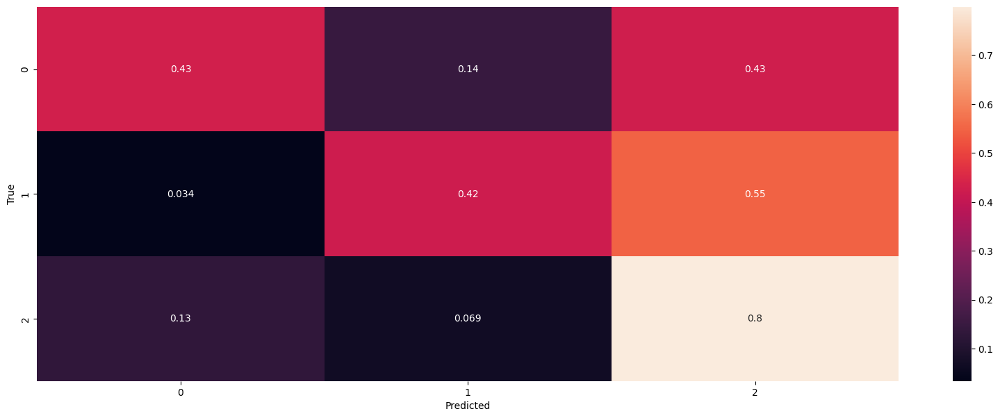

In [ ]:
ccm = tf.math.confusion_matrix(test_label, y_pred)
ccm = ccm/ccm.numpy().sum(axis=1)[:, tf.newaxis]

#display that new confusion matrix
plt.figure(figsize=(20,7))
sns.heatmap(
    ccm, annot=True)
plt.xlabel("Predicted")
plt.ylabel("True")

In [ ]:
print(classification_report(test_label, y_pred))

              precision    recall  f1-score   support

           0       0.73      0.43      0.54      1170
           1       0.55      0.42      0.48       740
           2       0.52      0.80      0.63      1209

    accuracy                           0.57      3119
   macro avg       0.60      0.55      0.55      3119
weighted avg       0.61      0.57      0.56      3119

